In [ ]:
# Import necessary packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
import seaborn as sns
sns.set()

In [ ]:
!git clone https://github.com/hardik0/AI-for-Medicine-Specialization
%cd AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/

Cloning into 'AI-for-Medicine-Specialization'...
remote: Enumerating objects: 1601, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 1601 (delta 9), reused 2 (delta 0), pack-reused 1573 (from 1)
Receiving objects: 100% (1601/1601), 720.36 MiB | 59.16 MiB/s, done.
Resolving deltas: 100% (30/30), done.
Updating files: 100% (1497/1497), done.
/content/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis


In [ ]:
%ls nih/

densenet.hdf5  images_small/  pretrained_model.h5  test.csv  train-small.csv  valid-small.csv


In [ ]:
# Read csv file containing training datadata
train_df = pd.read_csv("nih/train-small.csv")
# Print first 8 rows
print(f'There are {train_df.shape[0]} rows and {train_df.shape[1]} columns in this data frame')
train_df.head(8)

There are 1000 rows and 16 columns in this data frame


,Image,Atelectasis,Cardiomegaly,Consolidation,Edema,Effusion,Emphysema,Fibrosis,Hernia,Infiltration,Mass,Nodule,PatientId,Pleural_Thickening,Pneumonia,Pneumothorax
0,00008270_015.png,0,0,0,0,0,0,0,0,0,0,0,8270,0,0,0
1,00029855_001.png,1,0,0,0,1,0,0,0,1,0,0,29855,0,0,0
2,00001297_000.png,0,0,0,0,0,0,0,0,0,0,0,1297,1,0,0
3,00012359_002.png,0,0,0,0,0,0,0,0,0,0,0,12359,0,0,0
4,00017951_001.png,0,0,0,0,0,0,0,0,1,0,0,17951,0,0,0
5,00001232_002.png,1,1,0,0,1,0,0,0,1,0,0,1232,0,0,0
6,00017135_000.png,0,0,0,0,0,0,0,0,0,0,0,17135,0,0,0
7,00027235_000.png,0,0,0,0,0,0,0,0,0,0,0,27235,0,0,0


In [ ]:
# Look at the data type of each column and whether null values are present
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Image               1000 non-null   object
 1   Atelectasis         1000 non-null   int64 
 2   Cardiomegaly        1000 non-null   int64 
 3   Consolidation       1000 non-null   int64 
 4   Edema               1000 non-null   int64 
 5   Effusion            1000 non-null   int64 
 6   Emphysema           1000 non-null   int64 
 7   Fibrosis            1000 non-null   int64 
 8   Hernia              1000 non-null   int64 
 9   Infiltration        1000 non-null   int64 
 10  Mass                1000 non-null   int64 
 11  Nodule              1000 non-null   int64 
 12  PatientId           1000 non-null   int64 
 13  Pleural_Thickening  1000 non-null   int64 
 14  Pneumonia           1000 non-null   int64 
 15  Pneumothorax        1000 non-null   int64 
dtypes: int64(15), object(1)
m

In [ ]:
# Eksik değer analizi
missing_values = train_df.isnull().sum()
print("Eksik Değer Analizi:")
print(missing_values)

# Eksik değer yüzdesini hesaplama
missing_percentage = (missing_values / len(train_df)) * 100
print("\nEksik Değer Yüzdesi:")
print(missing_percentage)

# PatientId analizi
unique_patient_count = train_df['PatientId'].nunique()
print(f"\nBenzersiz hasta sayısı: {unique_patient_count}")

# Her bir hastanın görüntü sayısını analiz etme
patient_image_counts = train_df['PatientId'].value_counts()
print("\nHer bir hastanın görüntü sayısı:")
print(patient_image_counts.describe())

Eksik Değer Analizi:
Image                 0
Atelectasis           0
Cardiomegaly          0
Consolidation         0
Edema                 0
Effusion              0
Emphysema             0
Fibrosis              0
Hernia                0
Infiltration          0
Mass                  0
Nodule                0
PatientId             0
Pleural_Thickening    0
Pneumonia             0
Pneumothorax          0
dtype: int64

Eksik Değer Yüzdesi:
Image                 0.0
Atelectasis           0.0
Cardiomegaly          0.0
Consolidation         0.0
Edema                 0.0
Effusion              0.0
Emphysema             0.0
Fibrosis              0.0
Hernia                0.0
Infiltration          0.0
Mass                  0.0
Nodule                0.0
PatientId             0.0
Pleural_Thickening    0.0
Pneumonia             0.0
Pneumothorax          0.0
dtype: float64

Benzersiz hasta sayısı: 928

Her bir hastanın görüntü sayısı:
count    928.000000
mean       1.077586
std        0.341981
min   

In [ ]:
print(f"The total patient ids are {train_df['PatientId'].count()}, from those the unique ids are {train_df['PatientId'].value_counts().shape[0]} ")

The total patient ids are 1000, from those the unique ids are 928 


In [ ]:
columns = train_df.keys()
columns = list(columns)
print(columns)

['Image', 'Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'PatientId', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


In [ ]:
# Remove unnecesary elements
columns.remove('Image')
columns.remove('PatientId')
# Get the total classes
print(f"There are {len(columns)} columns of labels for these conditions: {columns}")

There are 14 columns of labels for these conditions: ['Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


In [ ]:
# Print out the number of positive labels for each class
for column in columns:
    print(f"The class {column} has {train_df[column].sum()} samples")

The class Atelectasis has 106 samples
The class Cardiomegaly has 20 samples
The class Consolidation has 33 samples
The class Edema has 16 samples
The class Effusion has 128 samples
The class Emphysema has 13 samples
The class Fibrosis has 14 samples
The class Hernia has 2 samples
The class Infiltration has 175 samples
The class Mass has 45 samples
The class Nodule has 54 samples
The class Pleural_Thickening has 21 samples
The class Pneumonia has 10 samples
The class Pneumothorax has 38 samples


Display Random Images

Seçilen Görüntülerin Etiket Bilgileri:
Görüntü: 00002772_000.png, Etiketler: {'Atelectasis': 0, 'Cardiomegaly': 0, 'Consolidation': 0, 'Edema': 0, 'Effusion': 0, 'Emphysema': 0, 'Fibrosis': 0, 'Hernia': 0, 'Infiltration': 0, 'Mass': 0, 'Nodule': 0, 'PatientId': 2772, 'Pleural_Thickening': 0, 'Pneumonia': 0}
Görüntü: 00020787_000.png, Etiketler: {'Atelectasis': 0, 'Cardiomegaly': 0, 'Consolidation': 0, 'Edema': 0, 'Effusion': 0, 'Emphysema': 0, 'Fibrosis': 0, 'Hernia': 0, 'Infiltration': 0, 'Mass': 0, 'Nodule': 0, 'PatientId': 20787, 'Pleural_Thickening': 0, 'Pneumonia': 0}
Görüntü: 00028028_000.png, Etiketler: {'Atelectasis': 0, 'Cardiomegaly': 0, 'Consolidation': 0, 'Edema': 0, 'Effusion': 0, 'Emphysema': 0, 'Fibrosis': 0, 'Hernia': 0, 'Infiltration': 1, 'Mass': 0, 'Nodule': 0, 'PatientId': 28028, 'Pleural_Thickening': 0, 'Pneumonia': 0}
Görüntü: 00001806_004.png, Etiketler: {'Atelectasis': 0, 'Cardiomegaly': 0, 'Consolidation': 0, 'Edema': 0, 'Effusion': 0, 'Em

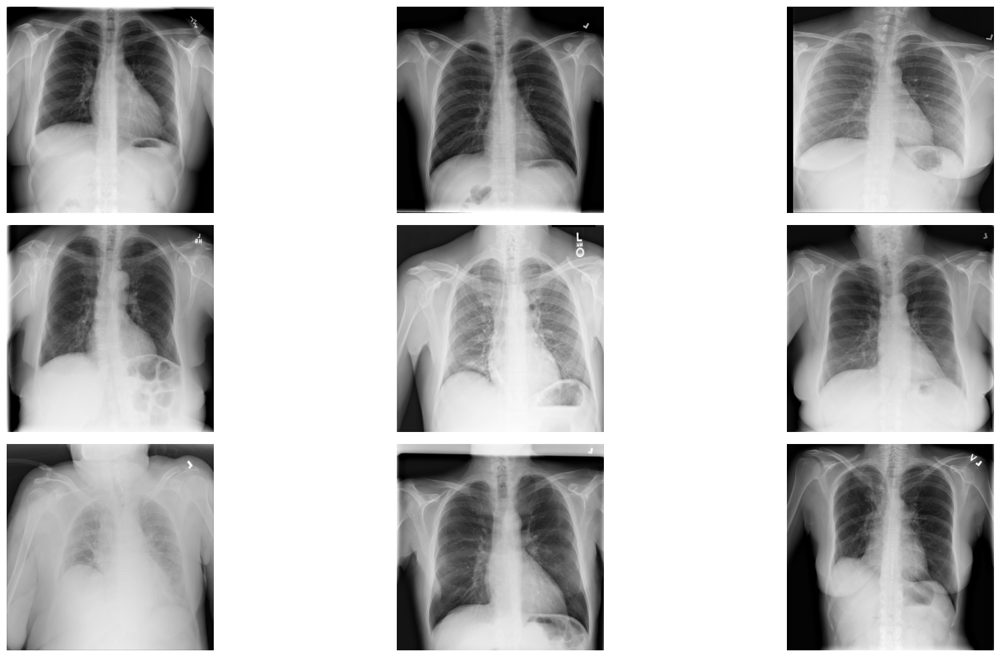

In [ ]:
# Extract numpy values from Image column in data frame
images = train_df['Image'].values

# Extract 9 random images from it
random_images = [np.random.choice(images) for i in range(9)]

# Location of the image dir
img_dir = 'nih/images_small/'

print('Display Random Images')

# Adjust the size of your images
plt.figure(figsize=(20,10))

# Iterate and plot random images
for i in range(9):
    plt.subplot(3, 3, i + 1)
    img = plt.imread(os.path.join(img_dir, random_images[i]))
    plt.imshow(img, cmap='gray')
    plt.axis('off')

# Rastgele seçilen görüntüler için etiket bilgisi
print("\nSeçilen Görüntülerin Etiket Bilgileri:")
for img_name in random_images:
    labels = train_df[train_df['Image'] == img_name].iloc[0, 1:-1].to_dict()
    print(f"Görüntü: {img_name}, Etiketler: {labels}")


# Adjust subplot parameters to give specified padding
plt.tight_layout()

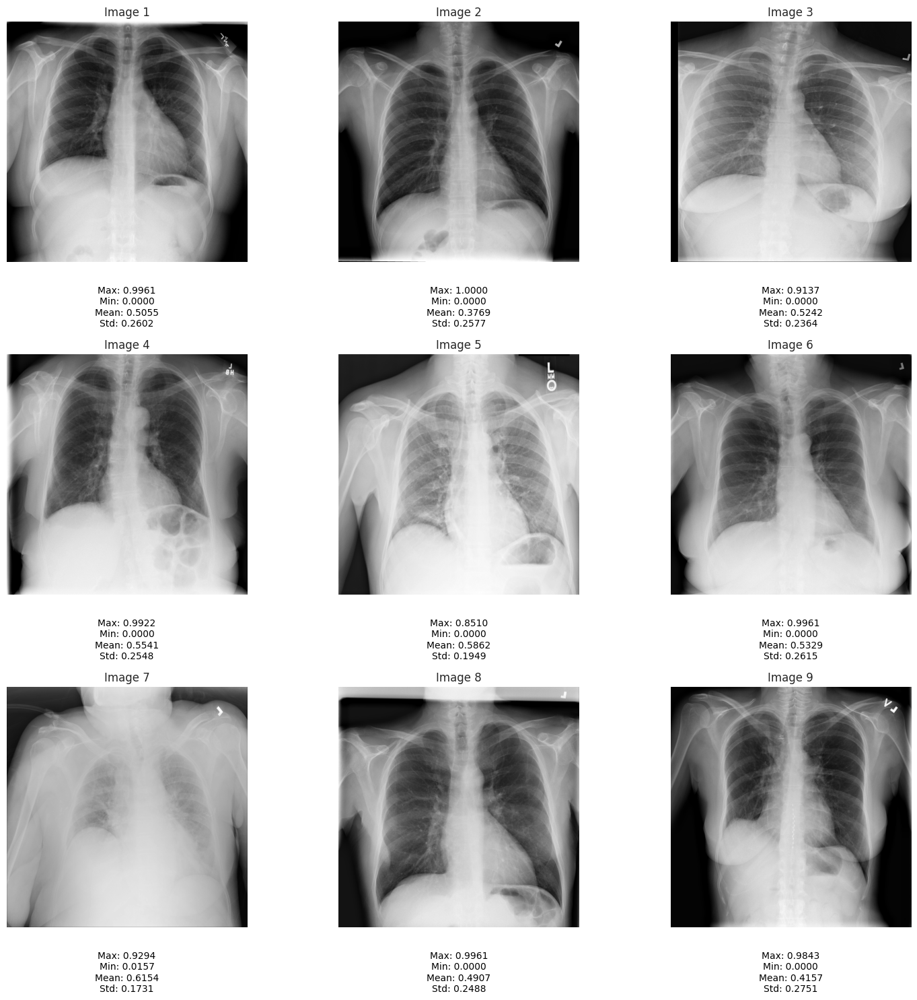

In [ ]:
# Plot ayarları
fig, axes = plt.subplots(3, 3, figsize=(15, 15))  # 3x3 grid
axes = axes.flatten()  # Kolay iterasyon için düzleştir

# Rastgele seçilen 9 görüntüyü ve istatistiklerini göster
for i, (ax, img_name) in enumerate(zip(axes, random_images)):
    # Görüntüyü yükle
    raw_image = plt.imread(os.path.join(img_dir, img_name))

    # Görüntü istatistiklerini hesapla
    img_max = raw_image.max()
    img_min = raw_image.min()
    img_mean = raw_image.mean()
    img_std = raw_image.std()

    # Görüntüyü göster
    ax.imshow(raw_image, cmap='gray')
    ax.axis('off')  # Eksenleri kapat
    ax.set_title(f"Image {i+1}")

    # İstatistikleri alt tarafa yaz
    stats_text = (
        f"Max: {img_max:.4f}\n"
        f"Min: {img_min:.4f}\n"
        f"Mean: {img_mean:.4f}\n"
        f"Std: {img_std:.4f}"
    )
    ax.text(0.5, -0.1, stats_text, transform=ax.transAxes,
            fontsize=10, va='top', ha='center', color='black', bbox=dict(facecolor='white', alpha=0.7))

# Layout düzeni
plt.tight_layout()
plt.show()

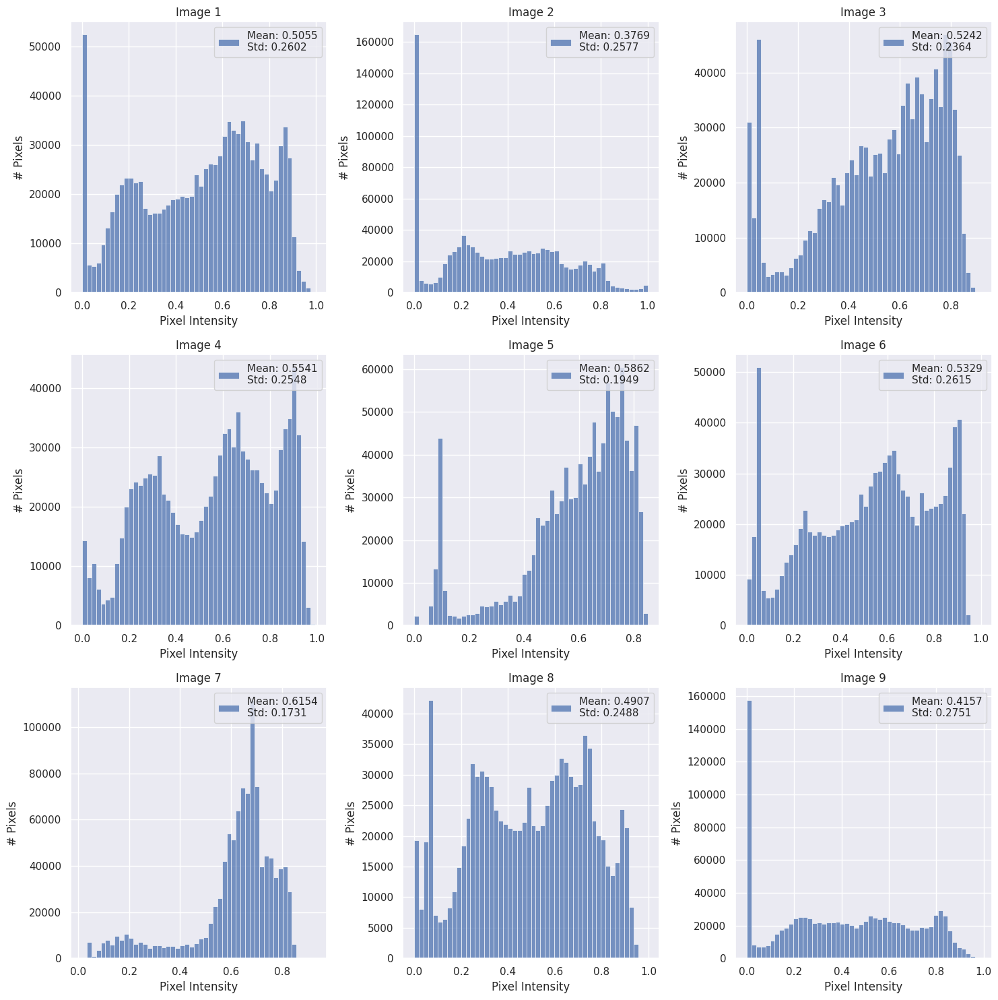

In [ ]:
# Plot ayarları: 3x3 grid
fig, axes = plt.subplots(3, 3, figsize=(15, 15))  # 3x3 grid
axes = axes.flatten()  # Kolay iterasyon için düzleştir

# 9 görüntü için histogramları oluştur
for i, (ax, img_name) in enumerate(zip(axes, random_images)):
    # Görüntüyü yükle
    raw_image = plt.imread(os.path.join(img_dir, img_name))

    # Görüntü histogramını çiz
    sns.histplot(
        raw_image.ravel(),  # Görüntüyü 1D vektöre dönüştür
        bins=50, kde=False, ax=ax,
        label=f'Mean: {np.mean(raw_image):.4f}\nStd: {np.std(raw_image):.4f}'
    )

    # Grafik başlığı ve etiketler
    ax.set_title(f'Image {i+1}', fontsize=12)
    ax.set_xlabel('Pixel Intensity')
    ax.set_ylabel('# Pixels')
    ax.legend(loc='upper right')  # İstatistik bilgisi ekle

# Layout düzeni
plt.tight_layout()
plt.show()

In [ ]:
pip install numpy

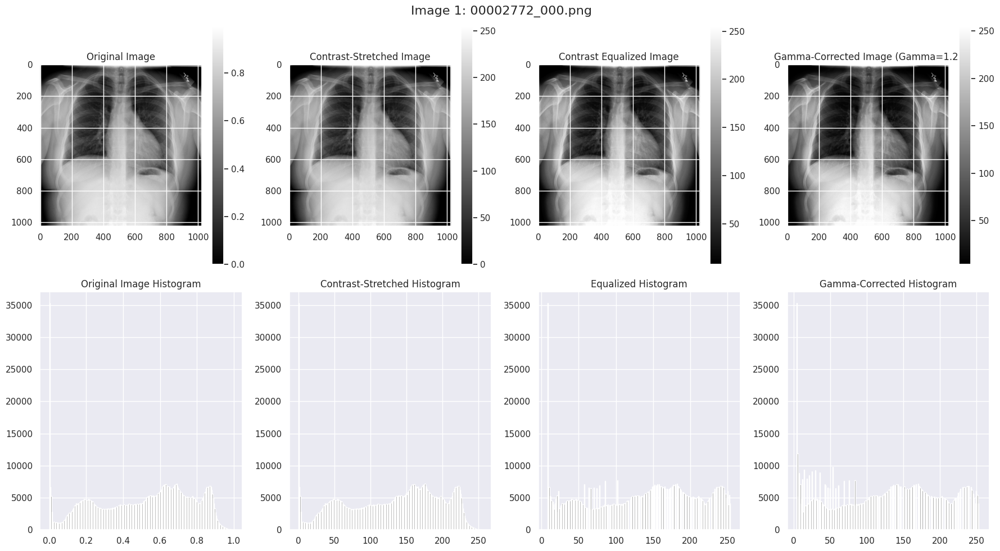

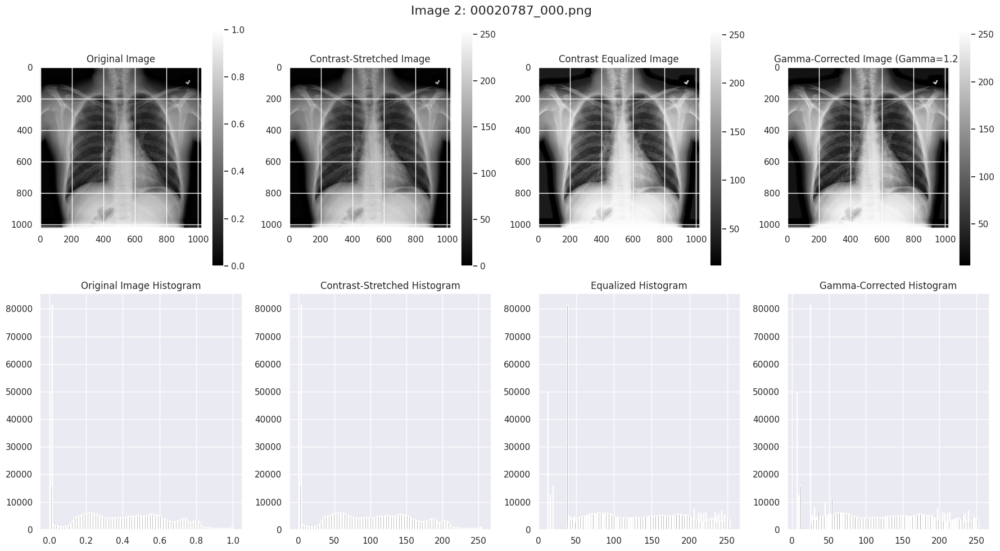

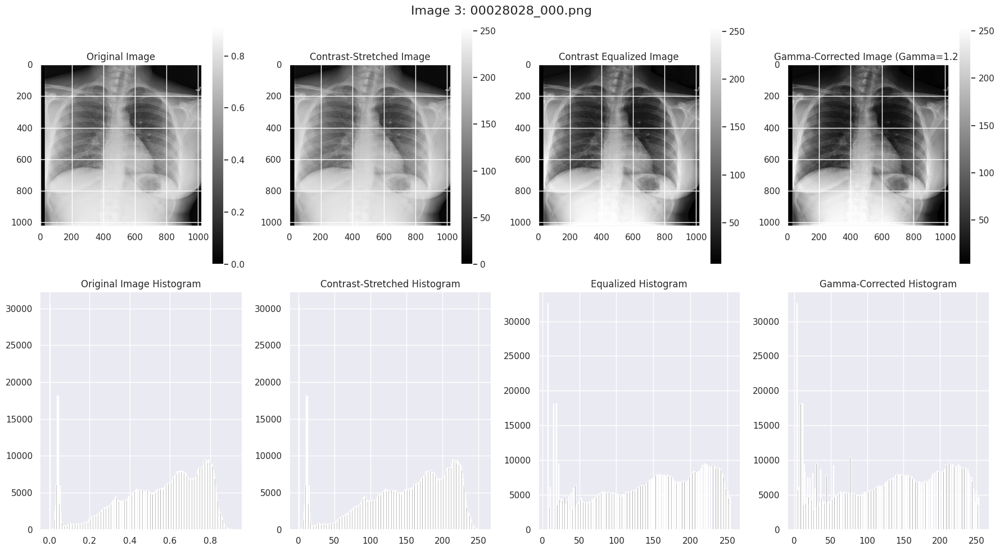

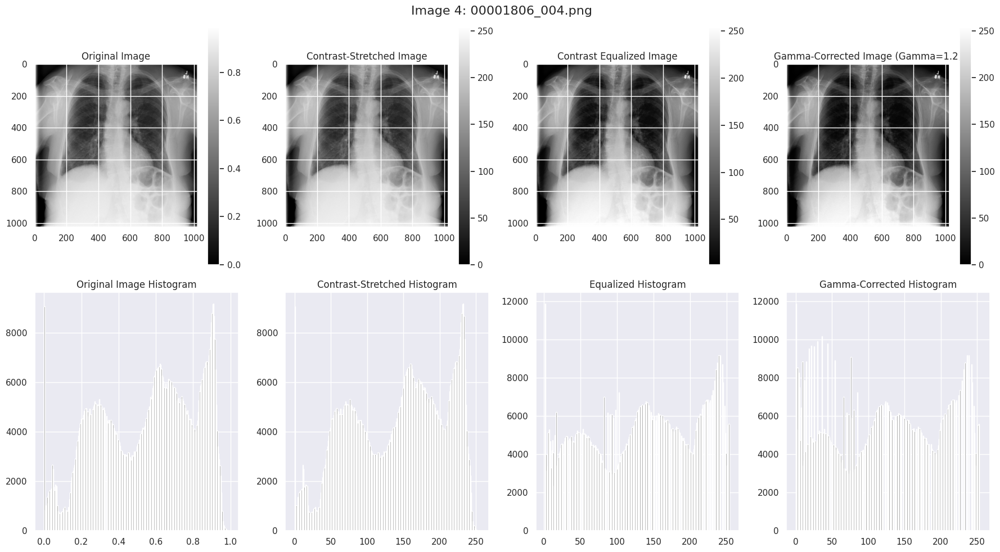

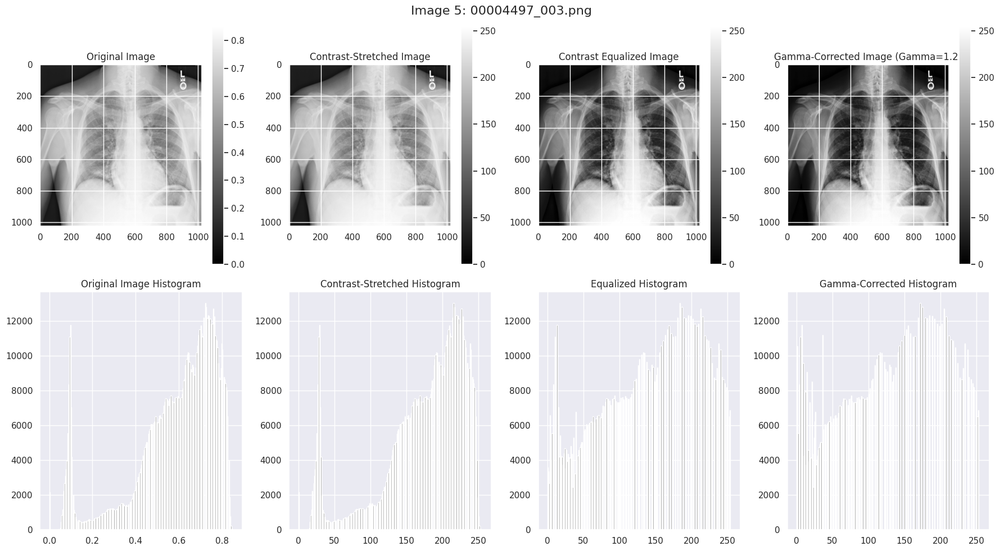

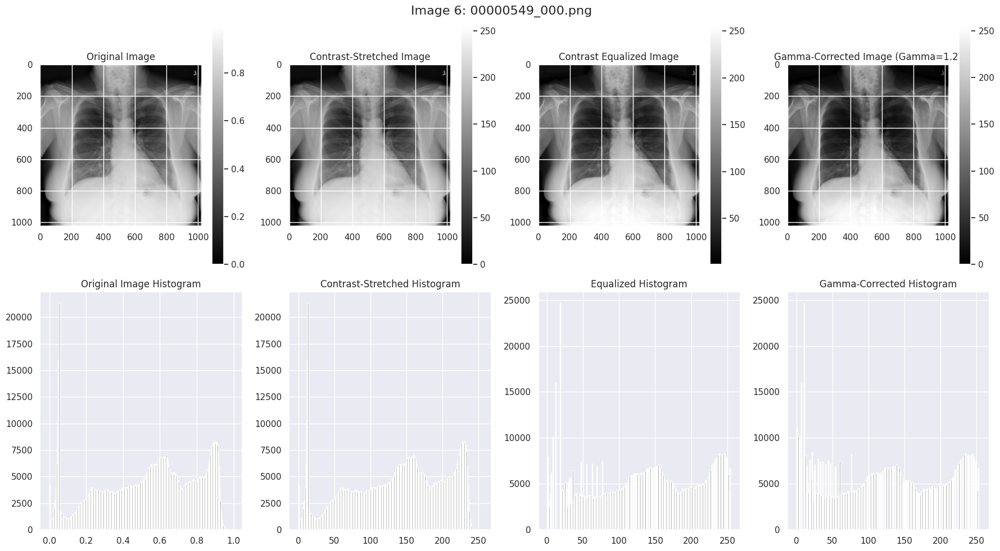

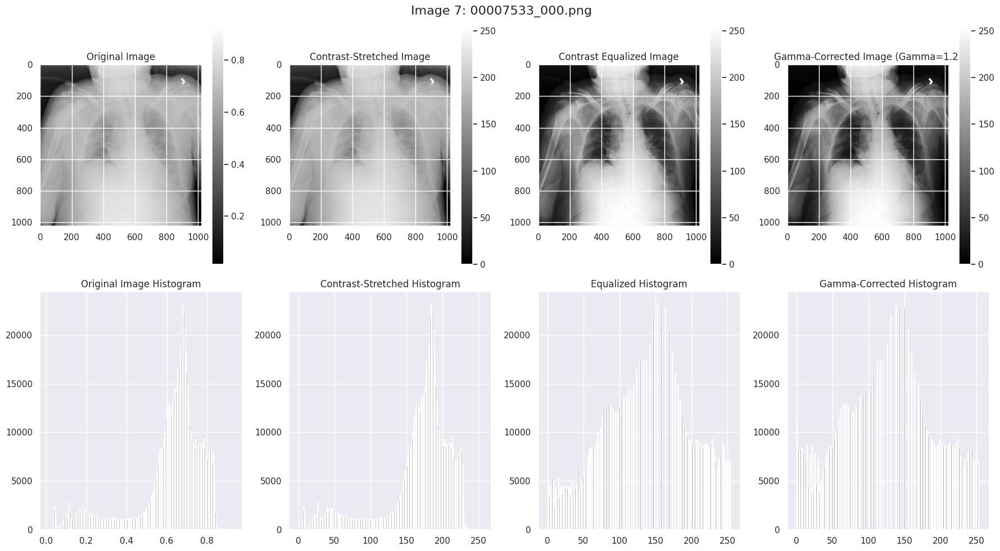

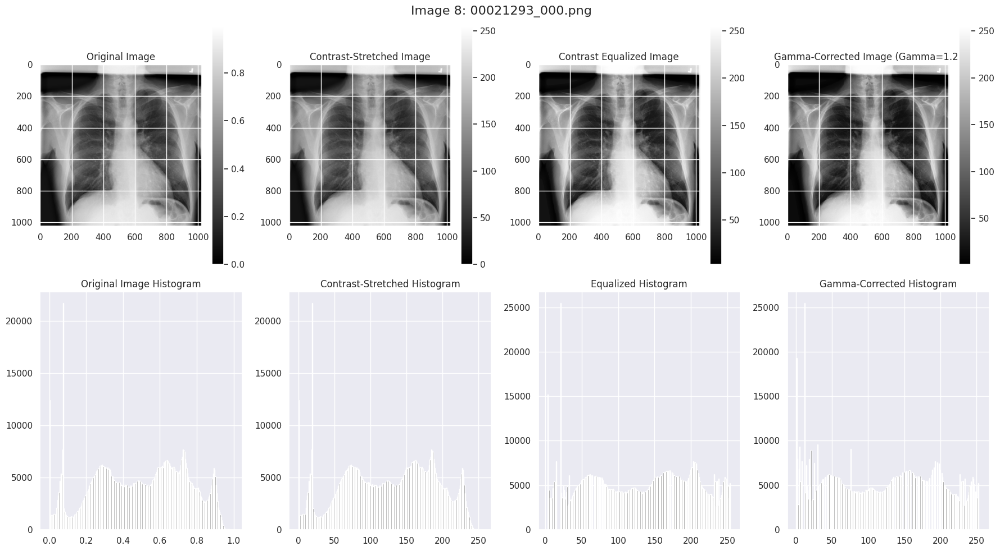

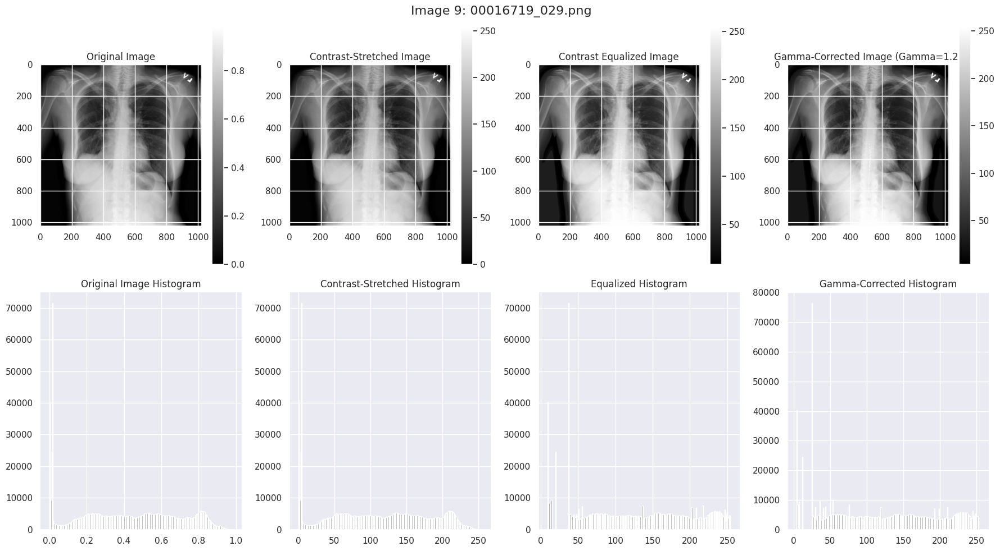


Görüntü 1 (00002772_000.png):
- Orijinal kontrast ile detay seviyesi analiz edildi.
- Kontrast germe ile kontrast arttı ve görüntü detayları netleşti.
- Histogram eşitleme, parlaklık dengesini iyileştirdi.
- Gamma düzeltme ile parlaklık kontrol edildi.

Görüntü 2 (00020787_000.png):
- Orijinal kontrast ile detay seviyesi analiz edildi.
- Kontrast germe ile kontrast arttı ve görüntü detayları netleşti.
- Histogram eşitleme, parlaklık dengesini iyileştirdi.
- Gamma düzeltme ile parlaklık kontrol edildi.

Görüntü 3 (00028028_000.png):
- Orijinal kontrast ile detay seviyesi analiz edildi.
- Kontrast germe ile kontrast arttı ve görüntü detayları netleşti.
- Histogram eşitleme, parlaklık dengesini iyileştirdi.
- Gamma düzeltme ile parlaklık kontrol edildi.

Görüntü 4 (00001806_004.png):
- Orijinal kontrast ile detay seviyesi analiz edildi.
- Kontrast germe ile kontrast arttı ve görüntü detayları netleşti.
- Histogram eşitleme, parlaklık dengesini iyileştirdi.
- Gamma düzeltme ile parlaklık 

In [ ]:
from skimage import exposure

gamma = 1.2  # İstenirse değiştirilebilir

# Seçilmiş 9 görüntü için işlemleri tekrarla
for i, img_name in enumerate(random_images):
    # Görüntüyü yükle
    raw_image = plt.imread(os.path.join(img_dir, img_name))

    # Step 1: Contrast Stretching
    min_val, max_val = raw_image.min(), raw_image.max()
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize to [0, 1]
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # Scale to [0, 255]

    # Step 2: Histogram Equalization
    equalized_image = exposure.equalize_hist(contrast_stretched)  # Values in [0, 1]
    equalized_image = (equalized_image * 255).astype(np.uint8)  # Scale to [0, 255]

    # Step 3: Gamma Correction
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Görselleştirme
    plt.figure(figsize=(18, 10))

    # Original image and histogram
    plt.subplot(2, 4, 1)
    plt.imshow(raw_image, cmap='gray')
    plt.title('Original Image')
    plt.colorbar()
    plt.subplot(2, 4, 5)
    plt.hist(raw_image.ravel(), bins=256, color='gray')
    plt.title("Original Image Histogram")

    # Contrast-stretched image and histogram
    plt.subplot(2, 4, 2)
    plt.imshow(contrast_stretched, cmap='gray')
    plt.title('Contrast-Stretched Image')
    plt.colorbar()
    plt.subplot(2, 4, 6)
    plt.hist(contrast_stretched.ravel(), bins=256, color='gray')
    plt.title("Contrast-Stretched Histogram")

    # Equalized image and histogram
    plt.subplot(2, 4, 3)
    plt.imshow(equalized_image, cmap='gray')
    plt.title('Contrast Equalized Image')
    plt.colorbar()
    plt.subplot(2, 4, 7)
    plt.hist(equalized_image.ravel(), bins=256, color='gray')
    plt.title("Equalized Histogram")

    # Gamma-corrected image and histogram
    plt.subplot(2, 4, 4)
    plt.imshow(gamma_corrected, cmap='gray')
    plt.title(f'Gamma-Corrected Image (Gamma={gamma})')
    plt.colorbar()
    plt.subplot(2, 4, 8)
    plt.hist(gamma_corrected.ravel(), bins=256, color='gray')
    plt.title("Gamma-Corrected Histogram")

    plt.suptitle(f'Image {i+1}: {img_name}', fontsize=16)
    plt.tight_layout()
    plt.show()

# Görüntü işleme sonrası analiz
for i, img_name in enumerate(random_images):
    print(f"\nGörüntü {i+1} ({img_name}):")
    print("- Orijinal kontrast ile detay seviyesi analiz edildi.")
    print("- Kontrast germe ile kontrast arttı ve görüntü detayları netleşti.")
    print("- Histogram eşitleme, parlaklık dengesini iyileştirdi.")
    print("- Gamma düzeltme ile parlaklık kontrol edildi.")


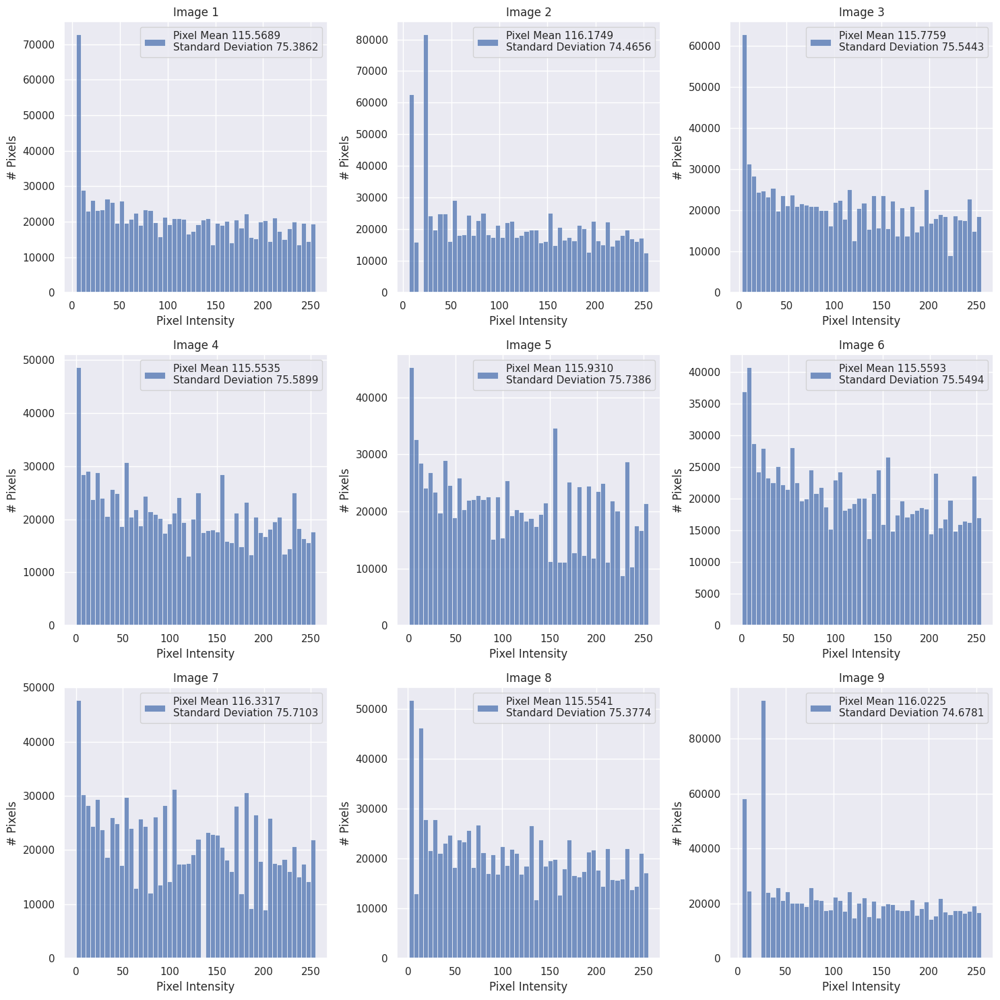

In [21]:
gamma = 1.2  # Gamma değeri

# Plot ayarları: 3x3 grid
fig, axes = plt.subplots(3, 3, figsize=(15, 15))  # 3x3 grid
axes = axes.flatten()  # Kolay iterasyon için düzleştir

# Seçilmiş 9 görüntü için işlemleri tekrarla
for i, (ax, img_name) in enumerate(zip(axes, random_images)):
    # Görüntüyü yükle
    raw_image = plt.imread(os.path.join(img_dir, img_name))

    # Step 1: Contrast Stretching
    min_val, max_val = raw_image.min(), raw_image.max()
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize to [0, 1]
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # Scale to [0, 255]

    # Step 2: Histogram Equalization
    equalized_image = exposure.equalize_hist(contrast_stretched)  # Values in [0, 1]
    equalized_image = (equalized_image * 255).astype(np.uint8)  # Scale to [0, 255]

    # Step 3: Gamma Correction
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Histogramı çiz
    sns.histplot(
        gamma_corrected.ravel(),
        bins=50, kde=False, ax=ax,
        label=f'Pixel Mean {np.mean(gamma_corrected):.4f}\nStandard Deviation {np.std(gamma_corrected):.4f}'
    )

    # Başlık ve etiketler
    ax.set_title(f'Image {i+1}', fontsize=12)
    ax.set_xlabel('Pixel Intensity')
    ax.set_ylabel('# Pixels')
    ax.legend(loc='upper right')

# Layout düzeni
plt.tight_layout()
plt.show()


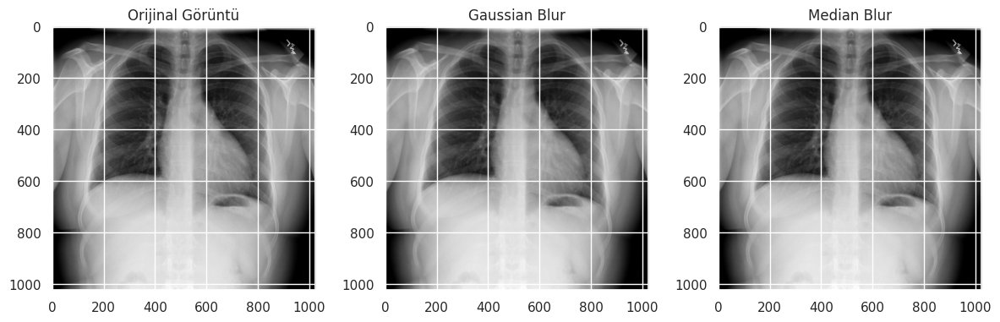

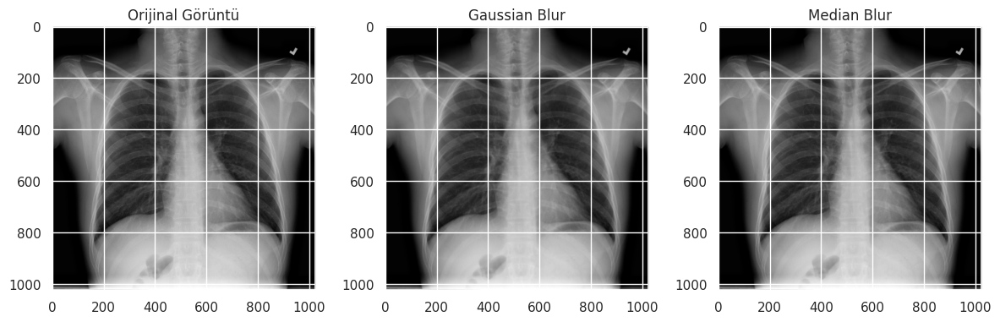

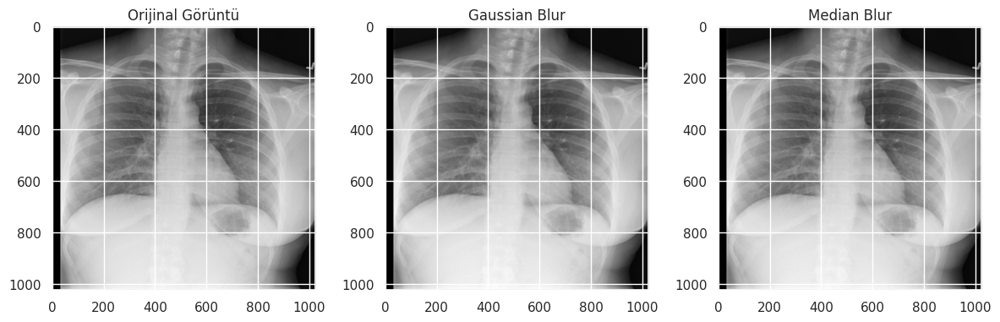

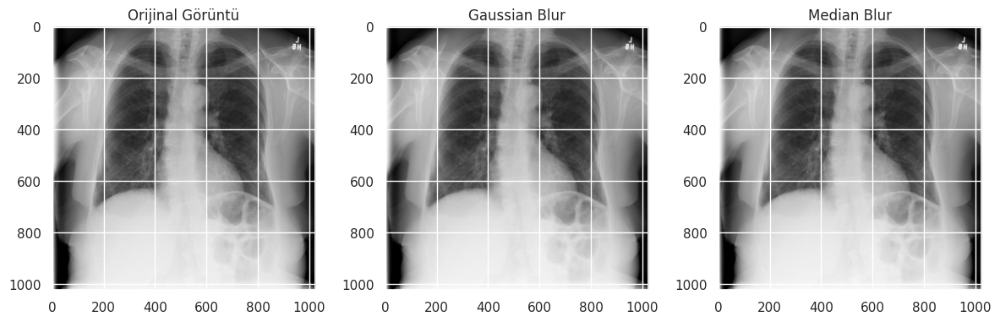

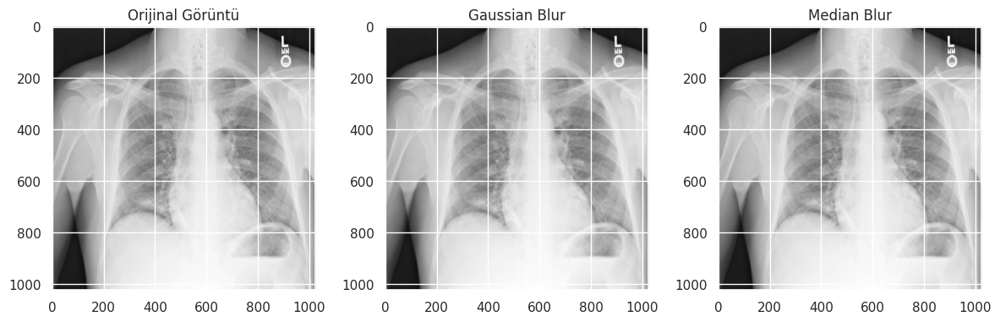

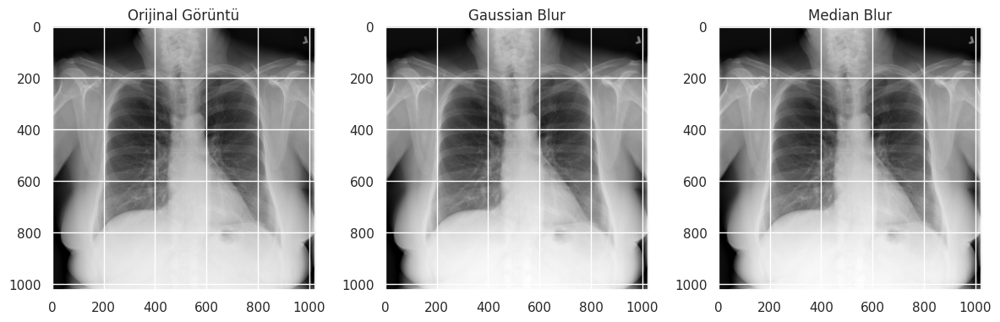

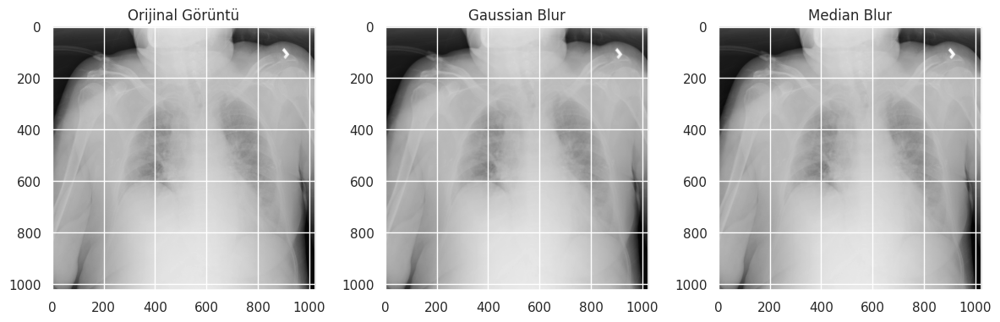

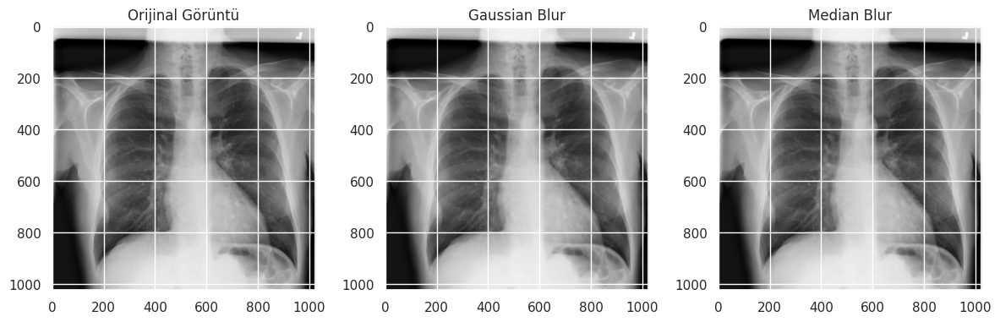

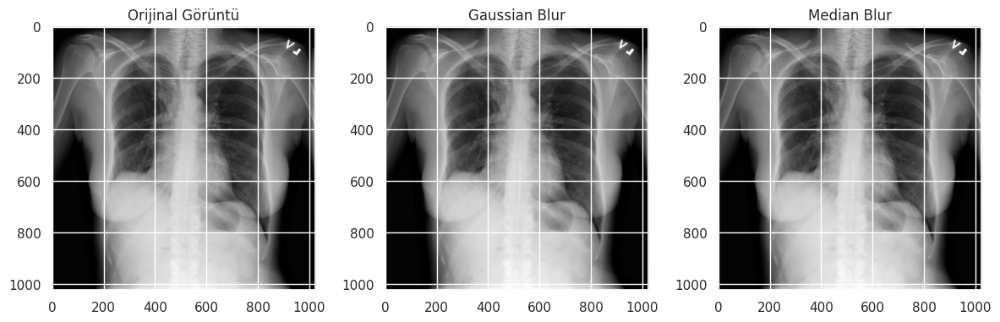

In [22]:
# Gürültü Azaltma: Median ve Gaussian Blur karşılaştırması
from skimage.filters import gaussian
from scipy.ndimage import median_filter

for i, img_name in enumerate(random_images):
    raw_image = plt.imread(os.path.join(img_dir, img_name))

    # Gaussian Blur
    gaussian_blur = gaussian(raw_image, sigma=1)

    # Median Blur
    median_blur = median_filter(raw_image, size=3)

    # Görselleştirme
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 3, 1)
    plt.imshow(raw_image, cmap='gray')
    plt.title("Orijinal Görüntü")

    plt.subplot(1, 3, 2)
    plt.imshow(gaussian_blur, cmap='gray')
    plt.title("Gaussian Blur")

    plt.subplot(1, 3, 3)
    plt.imshow(median_blur, cmap='gray')
    plt.title("Median Blur")

    plt.tight_layout()
    plt.show()


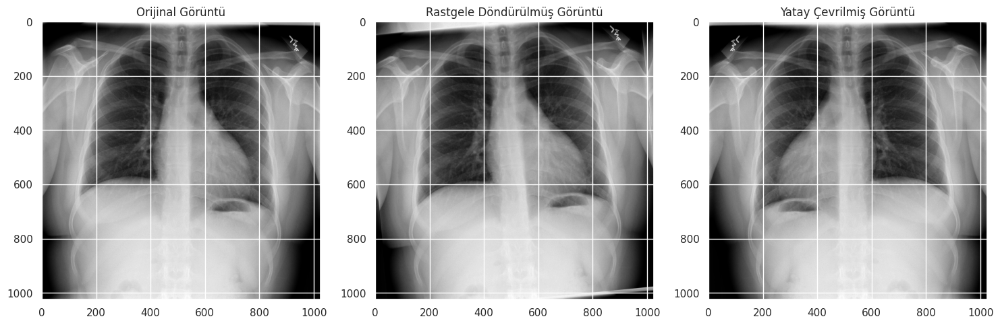

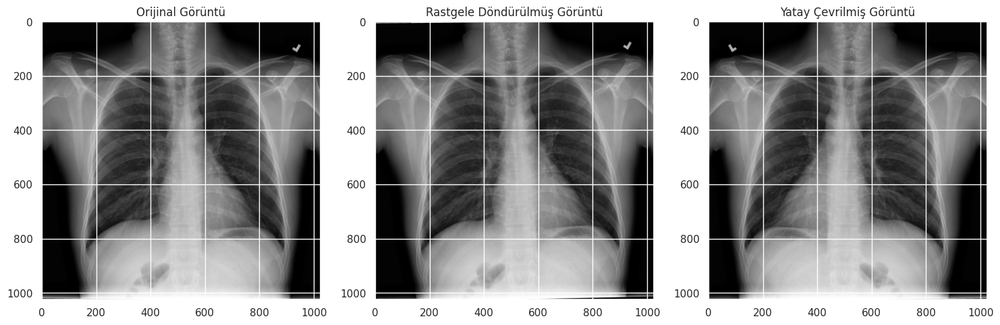

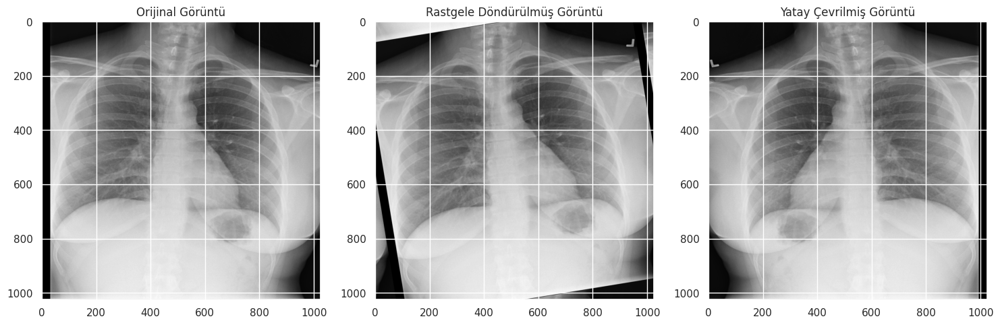

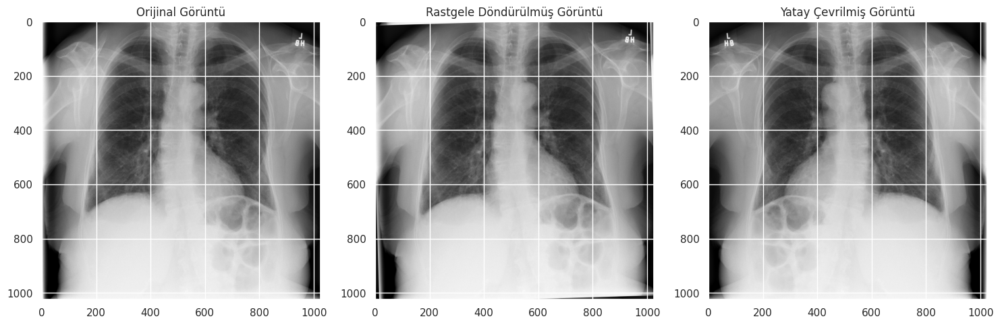

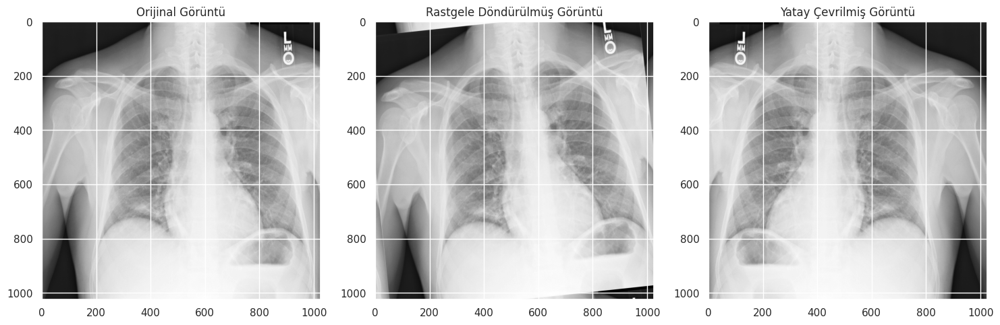

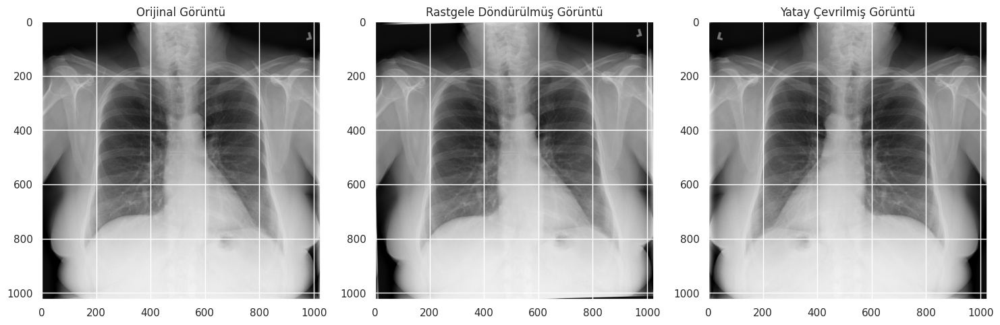

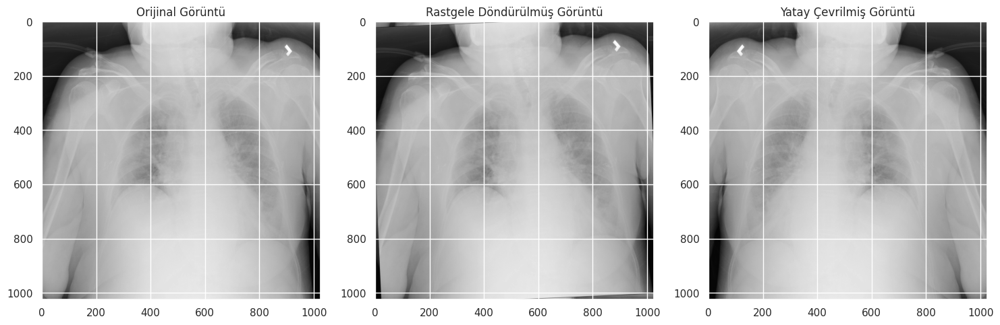

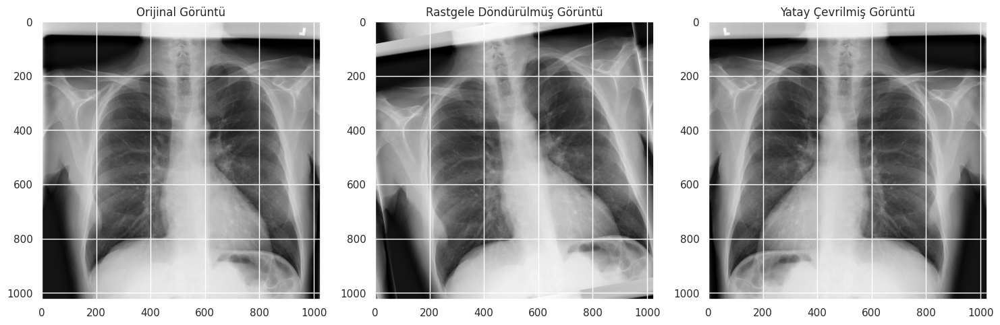

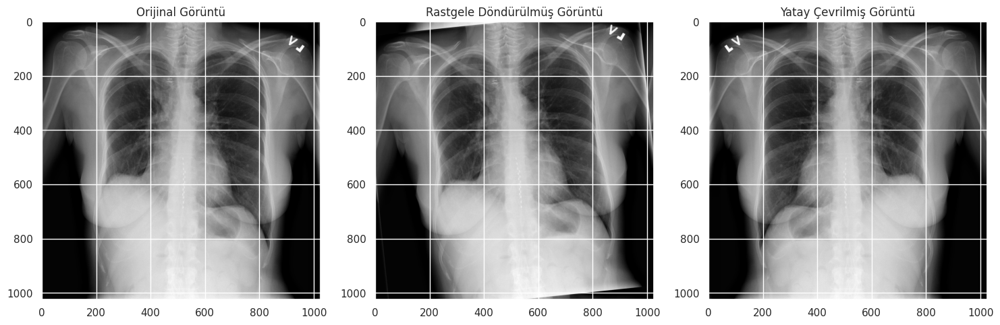

In [23]:
# Rastgele döndürme ve ayna çevirme
from skimage.transform import rotate

for i, img_name in enumerate(random_images):
    raw_image = plt.imread(os.path.join(img_dir, img_name))

    # Rastgele açıyla döndürme
    rotated_image = rotate(raw_image, angle=np.random.uniform(0, 10), mode='wrap')

    # Yatay ayna çevirme
    flipped_image = np.fliplr(raw_image)

    # Görselleştirme
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 3, 1)
    plt.imshow(raw_image, cmap='gray')
    plt.title("Orijinal Görüntü")

    plt.subplot(1, 3, 2)
    plt.imshow(rotated_image, cmap='gray')
    plt.title("Rastgele Döndürülmüş Görüntü")

    plt.subplot(1, 3, 3)
    plt.imshow(flipped_image, cmap='gray')
    plt.title("Yatay Çevrilmiş Görüntü")

    plt.tight_layout()
    plt.show()


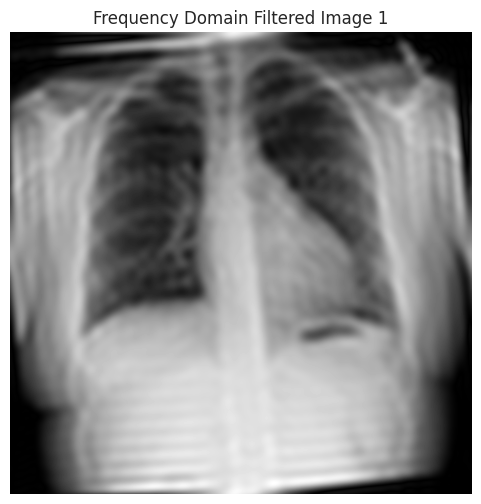

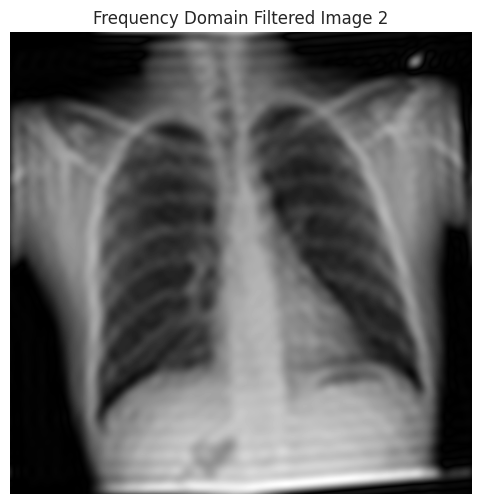

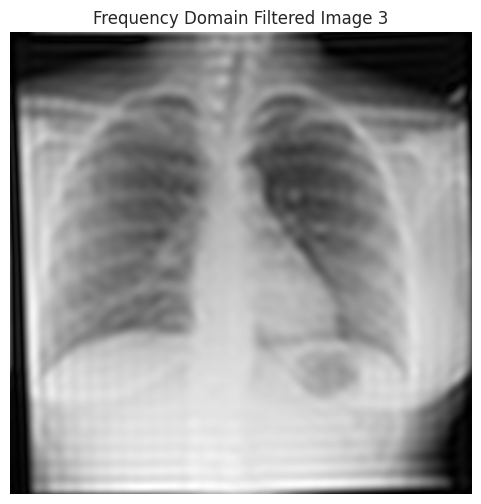

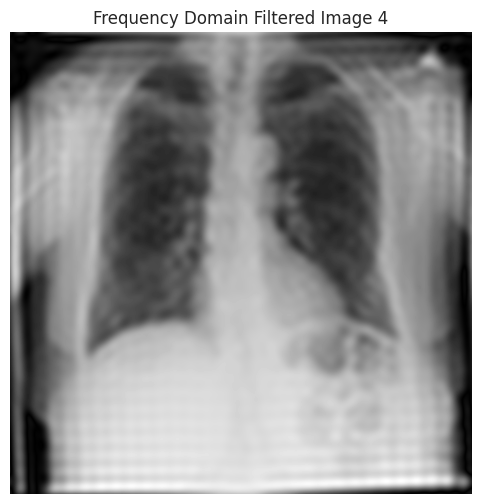

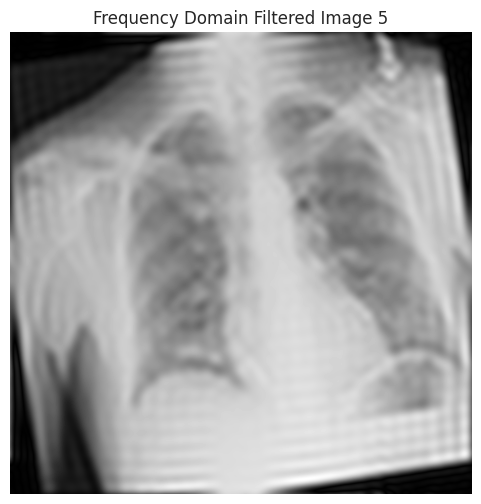

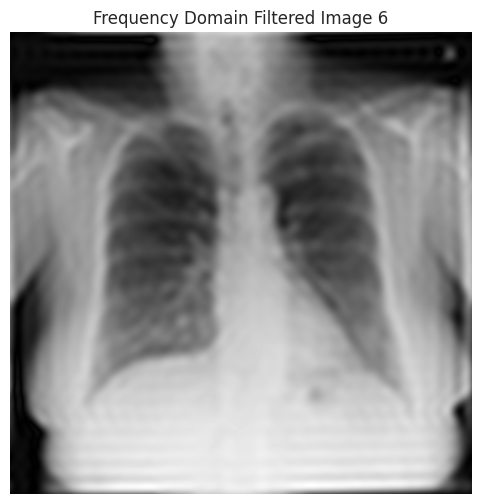

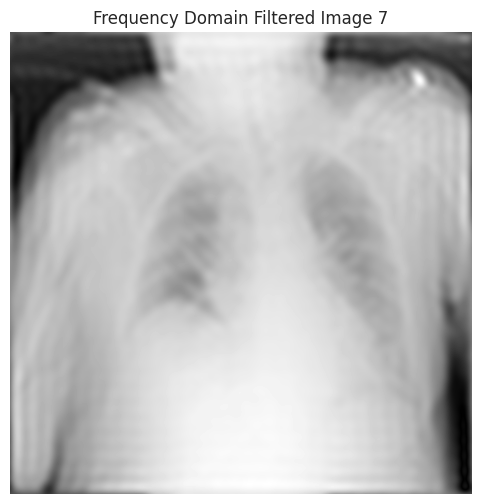

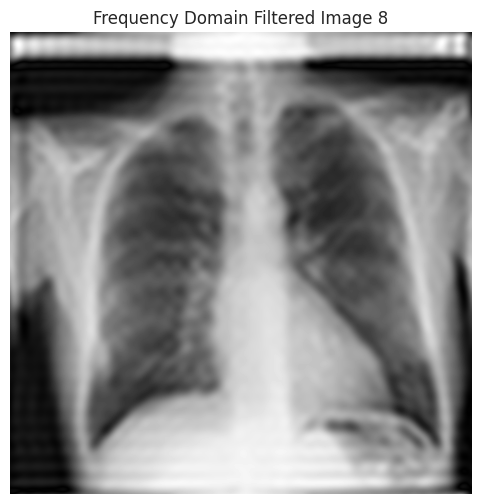

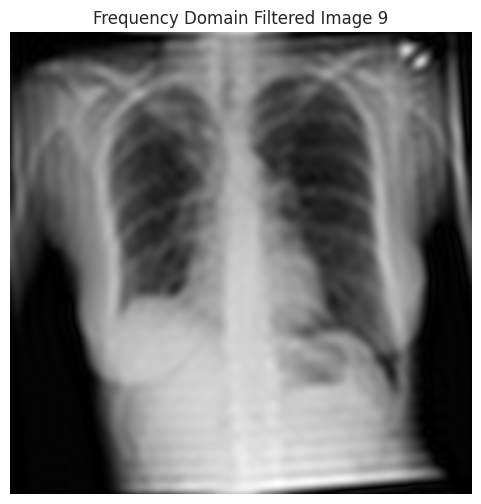

In [ ]:
import cv2

# 9 görüntüye Fourier Dönüşümü ve Frekans Alanı Filtreleme uygulama
for i, img_name in enumerate(random_images):
    # Görüntüyü yükle
    raw_image = plt.imread(os.path.join(img_dir, img_name))

    # Normalize edilmiş görüntü
    normalized_image = (raw_image - raw_image.min()) / (raw_image.max() - raw_image.min())
    normalized_image = (normalized_image * 255).astype(np.uint8)

    # Rastgele döndürme (örneklemek için)
    angle = np.random.randint(0, 11)
    center = (normalized_image.shape[1] // 2, normalized_image.shape[0] // 2)
    rotation_matrix = cv2.getRotationMatrix2D(center, angle, scale=1.0)
    rotated_image = cv2.warpAffine(normalized_image, rotation_matrix, (normalized_image.shape[1], normalized_image.shape[0]))

    # **1. Fourier Dönüşümü**
    dft = cv2.dft(np.float32(rotated_image), flags=cv2.DFT_COMPLEX_OUTPUT)
    dft_shifted = np.fft.fftshift(dft)

    # **2. Maske Oluşturma (Düşük Frekans)**
    rows, cols = rotated_image.shape
    crow, ccol = rows // 2, cols // 2
    mask = np.zeros((rows, cols, 2), np.uint8)
    mask[crow-30:crow+30, ccol-30:ccol+30] = 1  # Düşük frekans geçirgen

    # **3. Maskeyi Uygulama ve Ters Dönüşüm**
    fshift = dft_shifted * mask
    f_ishift = np.fft.ifftshift(fshift)
    filtered_image = cv2.idft(f_ishift)
    filtered_image = cv2.magnitude(filtered_image[:, :, 0], filtered_image[:, :, 1])

    # **4. Normalize ve Görselleştir**
    filtered_image = cv2.normalize(filtered_image, None, 0, 255, cv2.NORM_MINMAX)

    plt.figure(figsize=(6, 6))
    plt.imshow(filtered_image, cmap='gray')
    plt.title(f"Frequency Domain Filtered Image {i+1}")
    plt.axis("off")
    plt.show()


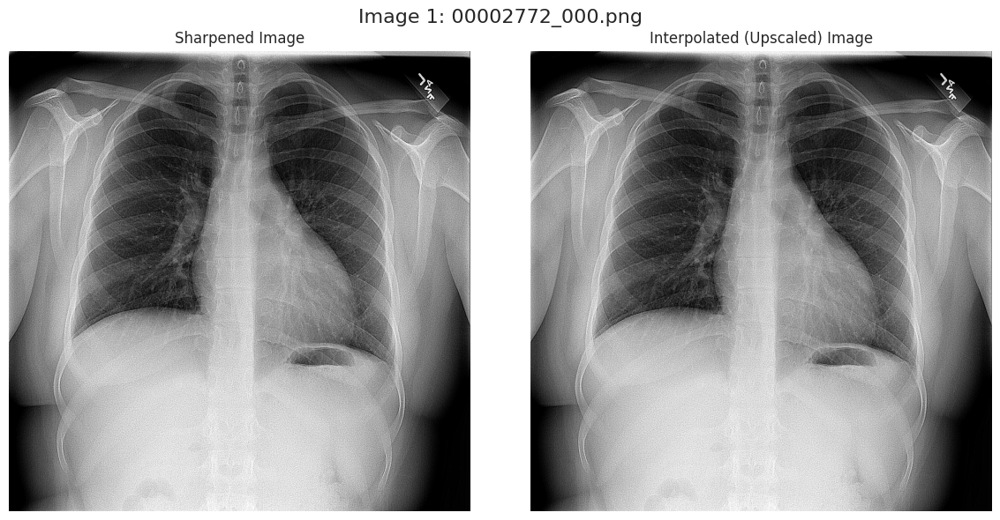

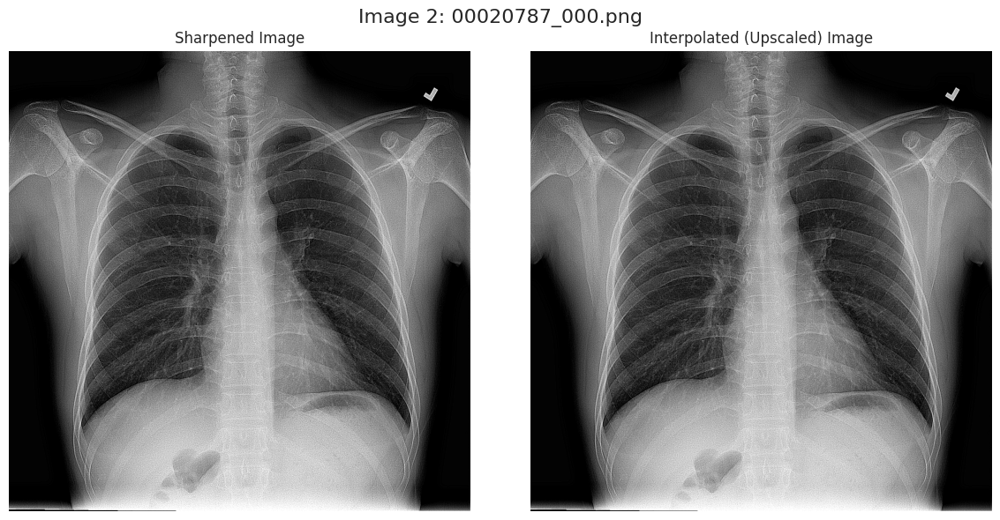

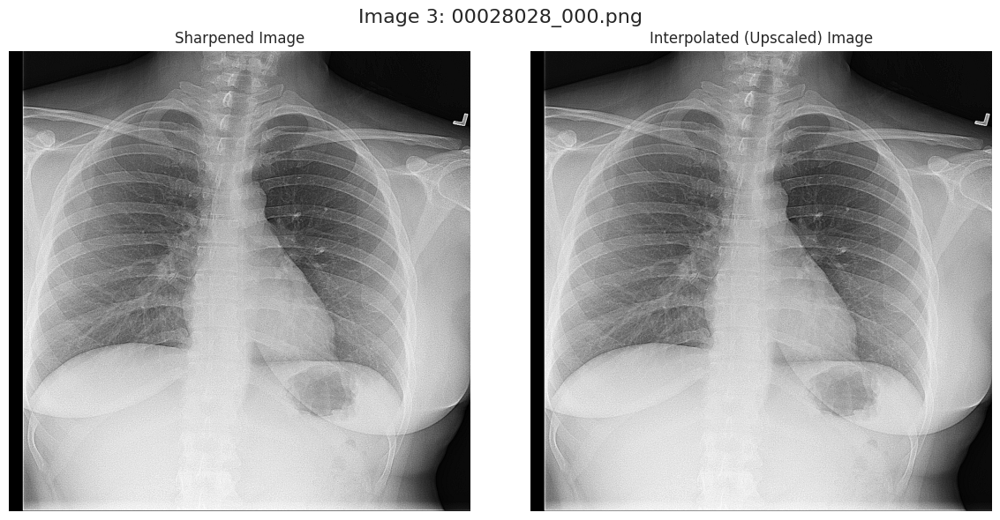

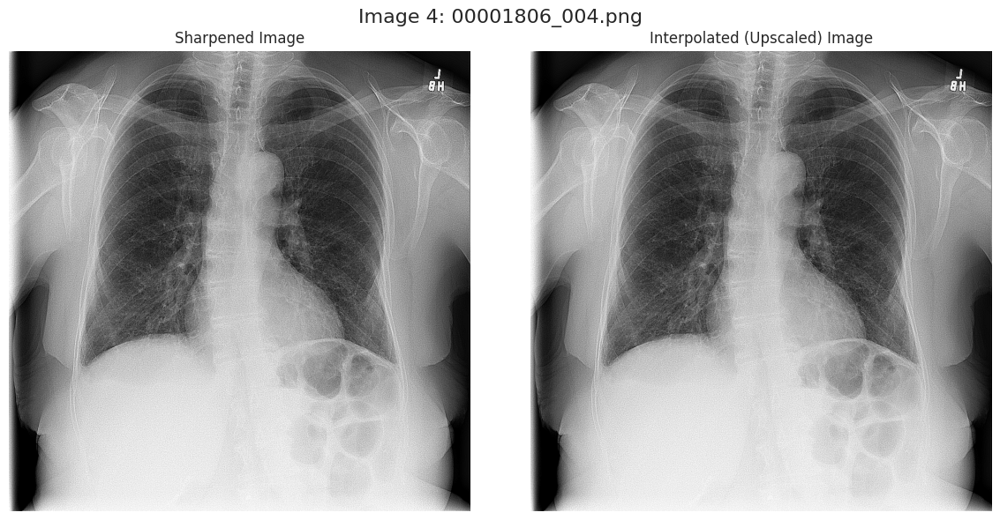

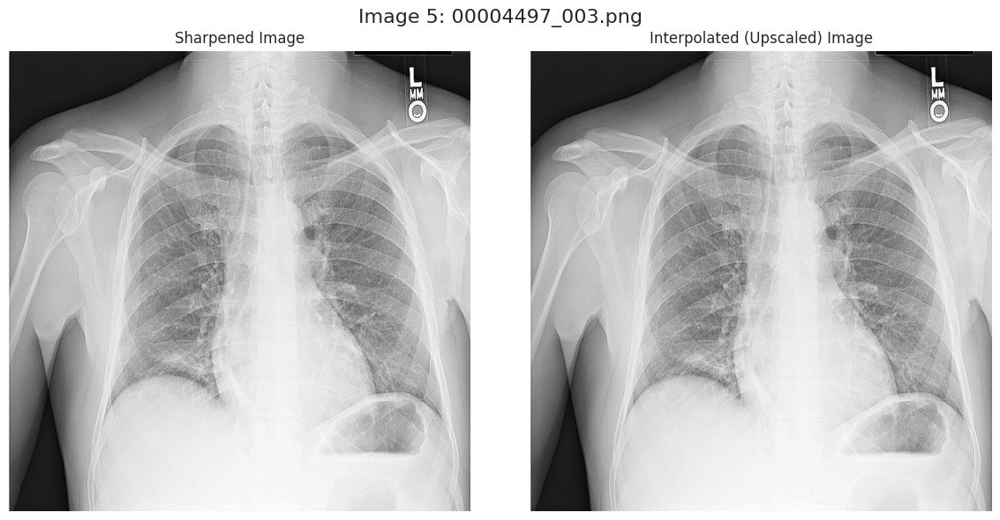

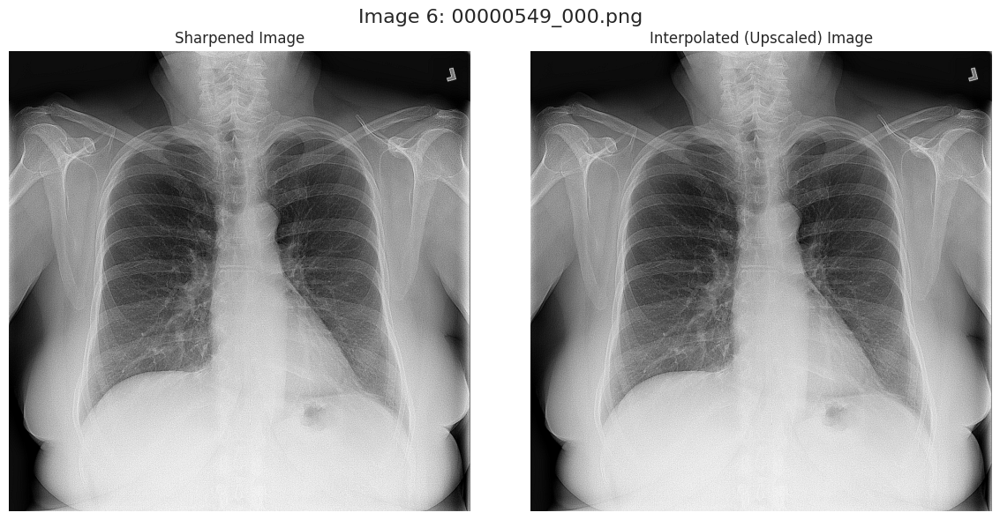

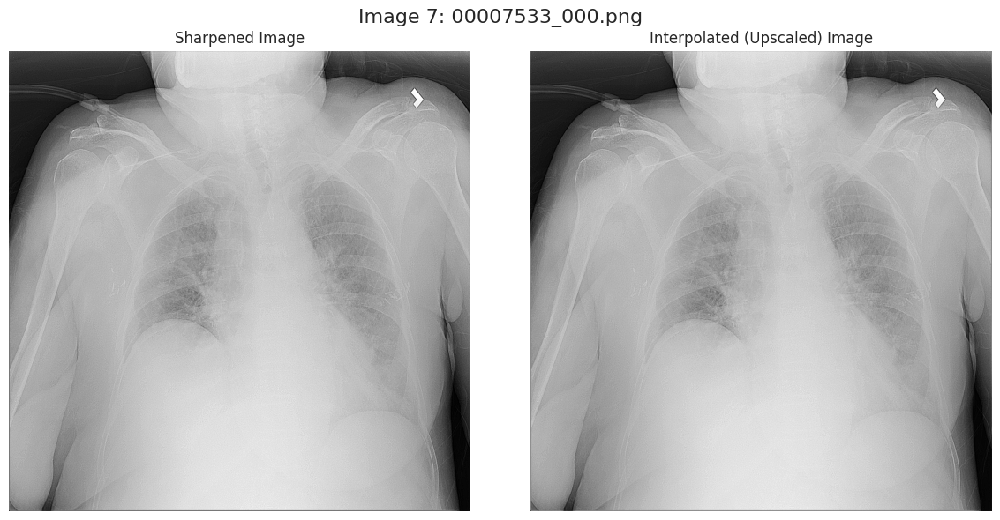

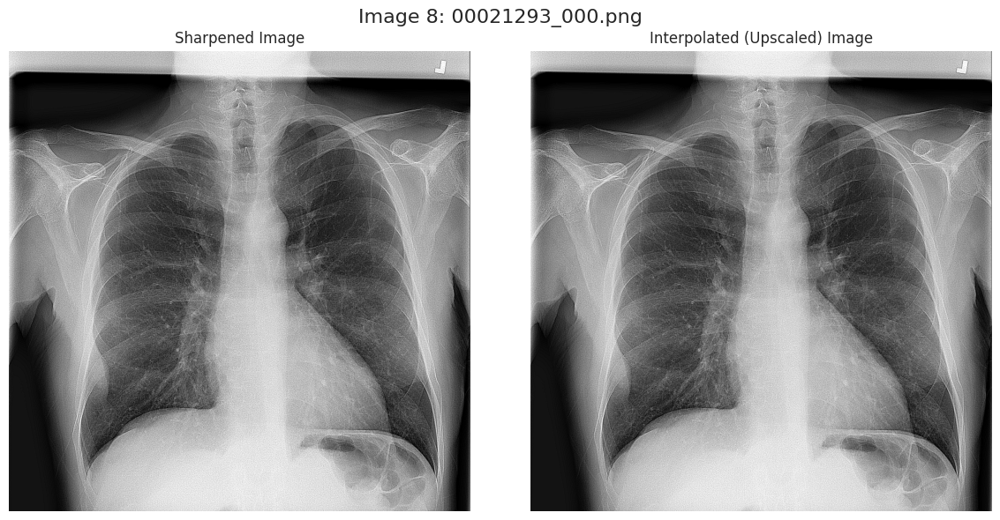

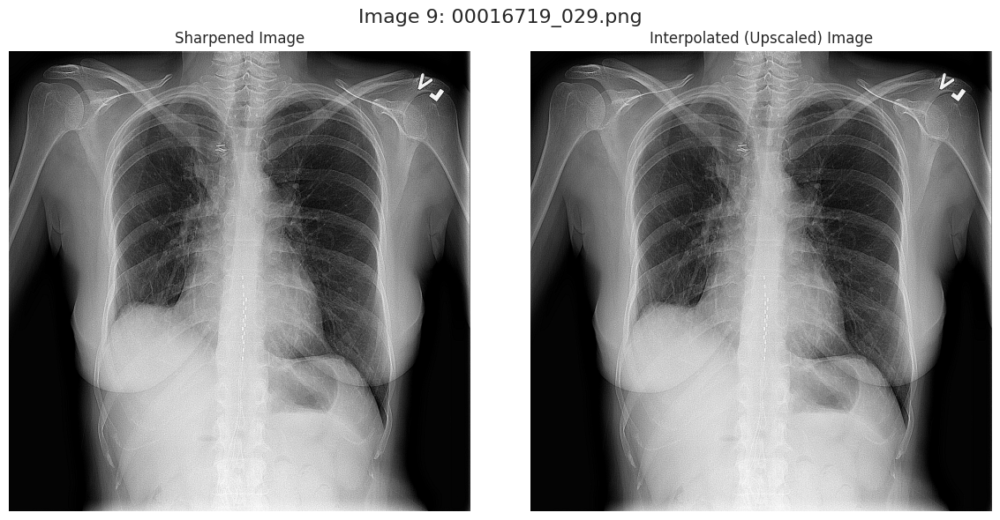

In [ ]:
from scipy.ndimage import zoom

# Seçilmiş 9 görüntüye keskinleştirme ve enterpolasyon uygulama
for i, img_name in enumerate(random_images):
    # Görüntüyü yükle
    raw_image = plt.imread(os.path.join(img_dir, img_name))

    # Normalize edilmiş görüntü
    normalized_image = (raw_image - raw_image.min()) / (raw_image.max() - raw_image.min())
    normalized_image = (normalized_image * 255).astype(np.uint8)

    # **1. Keskinleştirme (Unsharp Masking)**
    sharpening_kernel = np.array([[-1, -1, -1],
                                  [-1,  9, -1],
                                  [-1, -1, -1]])
    sharpened_image = np.clip(cv2.filter2D(normalized_image, -1, sharpening_kernel), 0, 255).astype(np.uint8)

    # **2. Bicubic Enterpolasyon (Büyütme)**
    scale_factor = 2
    resized_image = zoom(sharpened_image, scale_factor, order=3)  # Bicubic interpolation with `order=3`

    # **3. Sonuçları Görselleştir**
    plt.figure(figsize=(12, 6))
    plt.suptitle(f"Image {i+1}: {img_name}", fontsize=16)

    # Keskinleştirilmiş görüntü
    plt.subplot(1, 2, 1)
    plt.imshow(sharpened_image, cmap='gray')
    plt.title("Sharpened Image")
    plt.axis("off")

    # Büyütülmüş görüntü
    plt.subplot(1, 2, 2)
    plt.imshow(resized_image, cmap='gray')
    plt.title("Interpolated (Upscaled) Image")
    plt.axis("off")

    plt.tight_layout()
    plt.show()
